### Isabella Bermón Rojas cc.1000416364

#### Link repositorio :  https://github.com/IsabellaBermon/PDS/tree/Proyecto-Final

#### Link video : https://youtu.be/ey8d7iwEj8o

In [1]:
# Importar librerías propias
import graphic,generate
import numpy as np
import scipy.signal as signal
import matplotlib.pyplot as plt
import soundfile as sf
from scipy.signal import lfilter, firwin, freqz, kaiserord
from pydub.playback import play
from IPython.display import Audio # para escuchar la señal
from scipy import signal
!pip install pydub

D:\Usuarios\isabella\anaconda3\lib\site-packages\pydub\utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [2]:
# Función para graficar espectograma
def plot_spectrogram(signal, fs, title, freq_min=None, freq_max=None):
    plt.figure(figsize=(12, 6))
    Sxx, f, t, im = plt.specgram(signal, Fs=fs)
    plt.pcolormesh(t, f, 10 * np.log10(Sxx))
    plt.colorbar(label='Power Spectral Density (dB)')
    plt.title(title)
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')    
    if freq_min is not None and freq_max is not None:
        plt.ylim(freq_min, freq_max)  # Establecer límites en el eje de frecuencia    
    plt.tight_layout()
    plt.show()

# 1. Filtrado de notas musicales con filtros FIR

#### 1.1 Grafique la señal correspondiente a "piano_MgaRatAM.mp3". Debe normalizar la señal en amplitud, eliminar su nivel DC y crear su vector de tiempo dependiendo de su frecuencia de muestreo. Si la señal es estereo pasarla a mono y explicar ambas configuraciones.

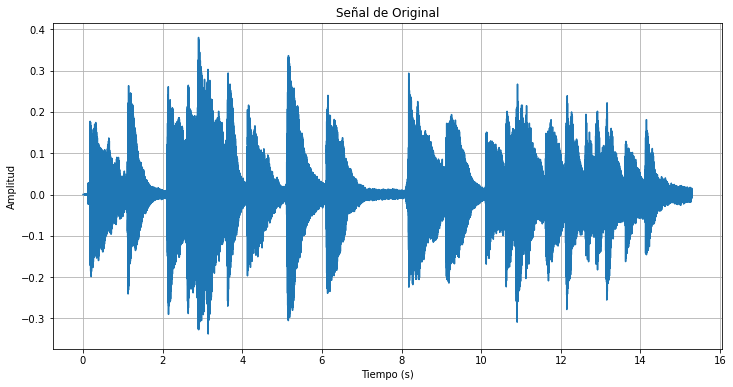

In [3]:
# Ruta del archivo de audio de entrada (MP3)
input_file = "piano_MgaRatAM.mp3"

# Cargar el archivo de audio
audio_signal, fs = sf.read(input_file)

# Convertir la señal a mono si es estéreo
if audio_signal.ndim > 1:
    audio_signal = np.mean(audio_signal, axis=1)

# Mostrar la gráfica de la señal de entrada
duration = len(audio_signal) / fs
time = np.linspace(0, duration, len(audio_signal))    
plt.figure(figsize=(12, 6))
plt.plot(time, audio_signal)
plt.title("Señal de Original")
plt.xlabel('Tiempo (s)')
plt.ylabel('Amplitud')
plt.grid()
plt.show()

# Escuchar audio 
Audio(audio_signal,rate=fs)

- Explicar señal mono y estereo

Las señales de audio pueden ser grabadas y reproducidas en diferentes formatos y configuraciones. La señal de audio mono es una señal de un solo canal que contiene una mezcla de los canales izquierdo y derecho. Por otro lado,  estéreo consta de dos canales: el canal izquierdo (L) y el canal derecho (R). Cada canal contiene información de audio independiente, lo que permite una mejor separación de los instrumentos y una sensación de amplitud o espacio en la reproducción. 


- ¿Después de escuchar el audio que puede notar y porqué cree que se puede cambiar a mono?

Al escuchar el audio se puede identificar el piano sonando todo el audio y se puede decir que está interpretando una melodía. También se escucha un poco de ruido de fondo pero solo es un instrumnto sonando por lo cual para la calidad del audio se espera que al parar de estereo a mono no hayan inconvenientes en la calidad del audio.

#### 1.2  Analice las componentes espectrales del audio de la forma que escoja y explique porqué, también encuentre el rango de frecuencias que se presentan en el audio. 

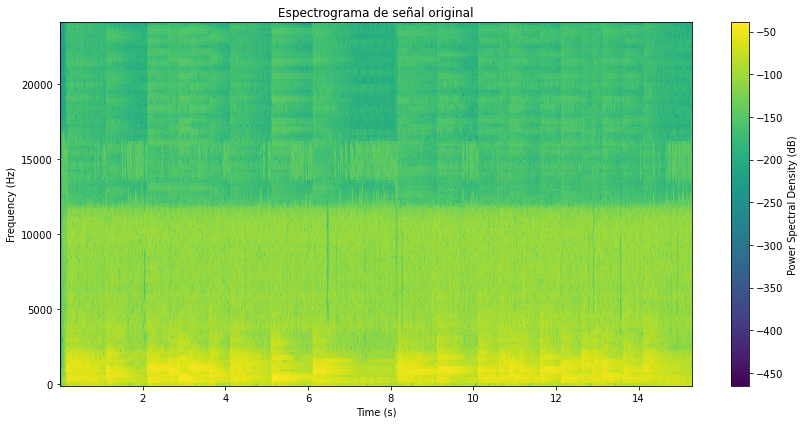

In [4]:
# Mostrar el espectrograma del audio
plot_spectrogram(audio_signal, fs, "Espectrograma de señal original")

Para realizar el análisis espectral que se pide se utiliza un espectograma. El espectrograma proporciona es una representación visual que muestra cómo varía la energía espectral de una señal a lo largo del tiempo y proporciona información sobre la distribución de energía en diferentes frecuencias a lo largo del tiempo.

- ¿Cuantas notas musicales se escuchanen el audio y concuerdan estas con el análisis espectral?

En el audio se pueden identificar 23 notas musicales de diferentes duraciones y en base al espectograma, aunque de con dificultad se puede evidenciar el cambio entre nota y nota se identifican aproximadamente 20. Esto se debe a la velocidad de algunas notas en cambiar.

- ¿Cuál es el rango de frecuencias del audio y como se interpretan las magnitudes de la energía espectral en cada rango?

El rango de frecuencias que se muestra en el espectograma indica que va hasta más de 20000, sin embargo se puede notar que hay mayor energía espectral de 0 a 5000Hz y después esta disminuye de 5000Hz a 1000Hz que se puede interpretar como los armónicos de las notas musicales y finalmente el rango faltante se puede interpretar como ruido que se puede escuchar en la grabación.

#### 1.3  Filtrado de la señal de audio original:
- Aplicar un filtro pasa-bandas FIR, con banda de transición de 3972Hz, rizado de 80db, frecuencia de corte inferior igual a 28 Hz y superior a 4000Hz. Utilizando 4 ventanas diferentes (Hamming, Blackman, Bartlett y Kaiser). Nota: no olvide normailzar las frecuencias de corte
- Mostrar la gráfica de cada filtro FIR junto con marcas en cada frecuencia de corte.
- Aplicar el filtro generado a la señal original y mostrar su espectograma.

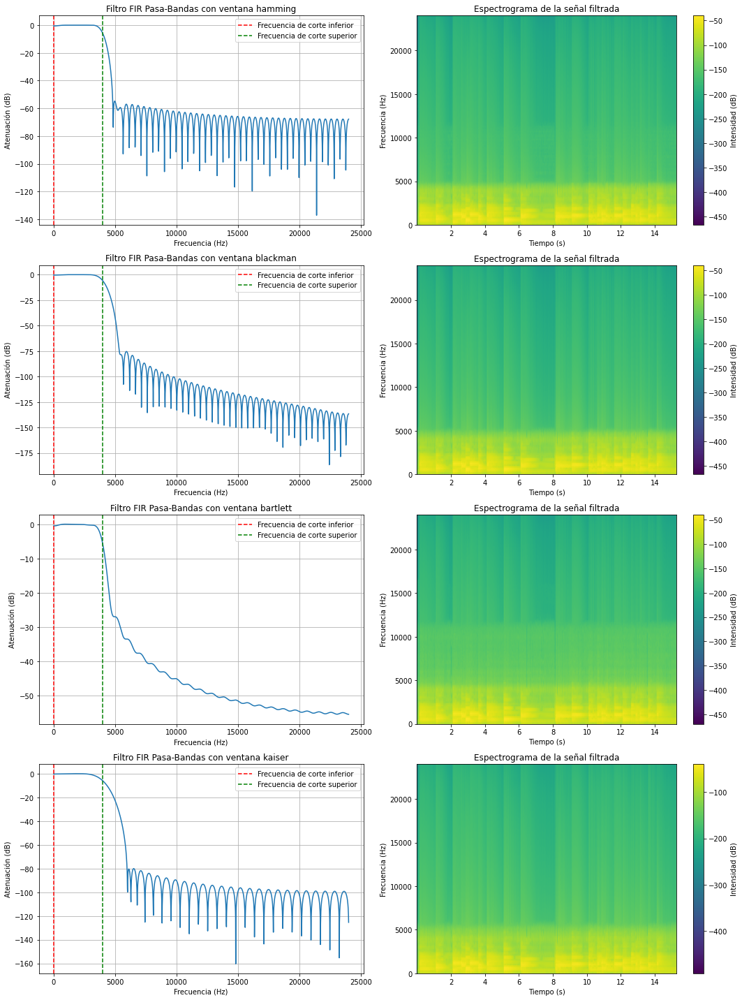

In [5]:
fs = 48000      # frecuencia de muestreo
delta_f =  3972    # banda de transición
ripple_db = 80  # rizado
f1 = 28        # frecuencia de corte inferior
f2 = 4000        # frecuencia de corte superior

nyq_rate = fs / 2.0
width = delta_f / nyq_rate
# Frecuencias de corte normalizadas
f1_normalized = f1 / nyq_rate
f2_normalized = f2 / nyq_rate

windows = ['hamming','blackman', 'bartlett','kaiser']
# windows_taps = []
filtered_audios = []
numtaps = 101

fig, axs = plt.subplots(4, 2, figsize=(15, 20))

for i,window_type in enumerate(windows):
    if (window_type=='kaiser'):
        N, beta = signal.kaiserord(ripple_db, width)  # orden y beta de Kaiser
        taps = signal.firwin(N, [f1_normalized, f2_normalized], window=('kaiser', beta), pass_zero=False)
    else:
        taps = signal.firwin(numtaps, [f1_normalized, f2_normalized], window=window_type, pass_zero=False)
#     windows_taps.append(taps)
    w, h = signal.freqz(taps, [1], worN=2000)

    # Gráfica del filtro FIR
    axs[i, 0].plot(nyq_rate * w / np.pi, 20 * np.log10(np.abs(h)))
    axs[i, 0].axvline(f1, color='r', linestyle='--', label='Frecuencia de corte inferior')
    axs[i, 0].axvline(f2, color='g', linestyle='--', label='Frecuencia de corte superior')
    axs[i, 0].set_xlabel('Frecuencia (Hz)')
    axs[i, 0].set_ylabel('Atenuación (dB)')
    axs[i, 0].set_title('Filtro FIR Pasa-Bandas con ventana {}'.format(window_type))
    axs[i, 0].legend()
    axs[i, 0].grid()

    # Aplicar filtro pasa banda a señal original
    filtered_signal = signal.lfilter(taps, 1, audio_signal)
    filtered_audios.append(filtered_signal)

    # Espectrograma de la señal filtrada
    ax_spec_filt = axs[i, 1].specgram(filtered_signal, Fs=fs, NFFT=256, noverlap=128)
    axs[i, 1].set_xlabel('Tiempo (s)')
    axs[i, 1].set_ylabel('Frecuencia (Hz)')
    axs[i, 1].set_title('Espectrograma de la señal filtrada') 
    fig.colorbar(ax_spec_filt[3], ax=axs[i, 1], label='Intensidad (dB)')

plt.tight_layout()
plt.show()

In [6]:
Audio(filtered_audios[0], rate=fs)

In [7]:
Audio(filtered_audios[3], rate=fs)

- Comparar los resultados de los diferentes filtros y discutir las diferencias observadas:

*Ventana Hamming:

La gráfica del filtro muestra una atenuación considerable en las frecuencias de corte, lo cual indica que el filtro está atenuando eficientemente las frecuencias fuera de la banda de interés. Por otro lado, en el espectrograma de la señal filtrada, se pueden observar las componentes espectrales dentro de la banda de interés con una buena resolución en frecuencia.

*Ventana Blackman:

Al igual que en el caso anterior, el filtro muestra una atenuación adecuada en las frecuencias de corte y una mayor ateniación a medida que aumenta la frecuencia. En el espectrograma, las componentes espectrales dentro de la banda de interés también se presentan con buena resolución, aunque se puede observar un poco más de dispersión comparado con la ventana Hamming.

*Ventana Bartlett:

La gráfica del filtro muestra una atenuación menos pronunciada en las frecuencias de corte en comparación con las ventanas anteriores. Por esto en el espectrograma se pueden observar más componentes fuera de la banda y se observa una banda de menor intensidad pero que sigue en el audio.

*Ventana Kaiser:

La gráfica del filtro muestra una atenuación pronunciada en las frecuencias de corte, similar a la ventana Hamming pero proporciona una atenuación más pronunciada de las frecuencias fuera de la banda. En el espectrograma, se pueden apreciar las componentes espectrales dentro de la banda de interés con una buena resolución en frecuencia, aunque con cierta dispersión mayor a HAmming pero menor a la ventana Blackman

- Analizar los efectos del filtrado en la señal de audio original en el dominio del tiempo: ¿Se pueden diferenciar los cambios mencionados al reproducir los audios?

No se pueden diferenciar los cambios de ventana al escuchar los audios. Lo que si se diferencia en todos los audios es que ya no se escucha ruido en el audio y solo las notas musicales del piano.

#### 1.4 Filtrado por notas musicales de la señal
A continuación se muestran los rangos de frecuencia de 7 notas musicales. Seleccione dos notas musicales y filtre esas notas musicales con dos ventanas diferentes (Hamming y Kaiser). Nota: use los mismo parámetros que para el filtro anterior.

- Frecuencia de corte 0 : 
f1 = 140       # frecuencia inferior (Re)
f2 = 155        # frecuencia superior (Re)

- Frecuencia de corte 1 :
f1 = 280        # frecuencia inferior (Do)
f2 = 320        # frecuencia superior (Do)

- Frecuencia de corte 2 :
f1 = 215        # frecuencia inferior (La)
f2 = 220        # frecuencia superior (La)

- Frecuencia de corte 3 :
f1 = 245        # frecuencia inferior (Si)
f2 = 255        # frecuencia superior (Si)

- Frecuencia de corte 4 :
f1 = 180        # frecuencia inferior (Fa)
f2 = 195        # frecuencia superior (Fa)

- Frecuencia de corte 5 :
f1 = 390        # frecuencia inferior (Sol)
f2 = 395        # frecuencia superior (Sol)

- Frecuencia de corte 6 :
f1 = 160        # frecuencia inferior (Mi)
f2 = 170        # frecuencia superior (Mi)

Filtrado de Re:

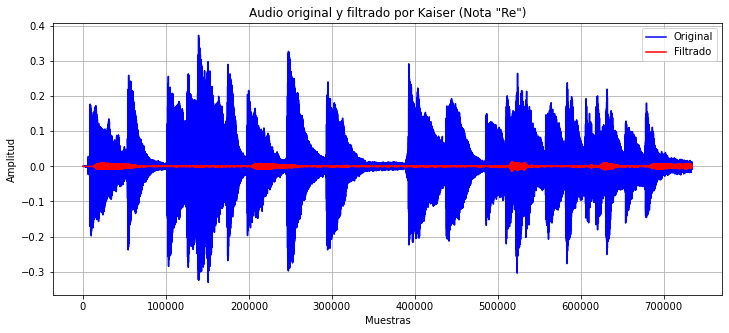

In [8]:
fs = 48000      # frecuencia de muestreo 
delta_f = 20   # banda de transición
ripple_db = 80  # rizado 
# Frecuencia de corte 0
f1 = 140       # frecuencia inferior (Re)
f2 = 155        # frecuencia superior (Re)

nyq_rate = fs / 2.0
width = delta_f / nyq_rate
N, beta = signal.kaiserord(ripple_db, width)  # orden y beta de Kaiser
taps = signal.firwin(N, [f1 / nyq_rate, f2 / nyq_rate] , window=('kaiser', beta), pass_zero=False)
filtered_audio = signal.lfilter(taps, 1, filtered_audios[0])

plt.figure(figsize=(12, 5))
plt.plot(filtered_audios[0], color='blue', label='Original')
plt.plot(filtered_audio, color='red', label='Filtrado')
plt.legend()
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Audio original y filtrado por Kaiser (Nota "Re")')
plt.grid()
plt.show()

Audio(filtered_audio, rate=fs)

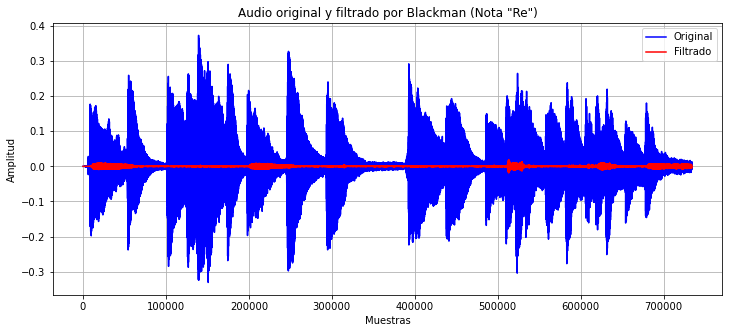

In [9]:
# Calcula el número de coeficientes del filtro
N = int(np.ceil((4 / width)))
taps = signal.firwin(N, [f1 / nyq_rate, f2 / nyq_rate], window='blackman', pass_zero=False)

filtered_audio = signal.lfilter(taps, 1, filtered_audios[0])

plt.figure(figsize=(12, 5))
plt.plot(filtered_audios[0], color='blue', label='Original')
plt.plot(filtered_audio, color='red', label='Filtrado')
plt.legend()
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Audio original y filtrado por Blackman (Nota "Re")')
plt.grid()
plt.show()

Audio(filtered_audio, rate=fs)

- ¿Qué diferencias alcanza a escuchar entre un filtrado y el otro? 

La diferenica es muy sutil y se escucha que mientras que el filtro con la ventana Kaiser atenua más las frecuencias no deseadas, en el filtro con la ventana Blackman todavía es puede escuchar casi como si fuiera ruido de otras frecuencias o pueden ser armónicos generados por otras notas.

Filtrado de La:

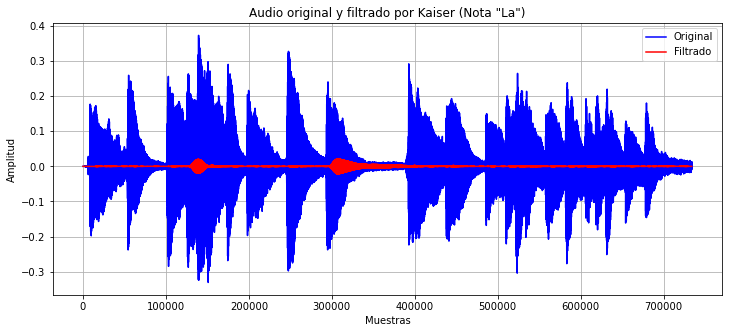

In [10]:
# Frecuencia de corte 2
f1 = 215       # frecuencia inferior (La)
f2 = 220        # frecuencia superior (La)

nyq_rate = fs / 2.0
width = delta_f / nyq_rate
N, beta = signal.kaiserord(ripple_db, width)  # orden y beta de Kaiser
taps = signal.firwin(N, [f1 / nyq_rate, f2 / nyq_rate] , window=('kaiser', beta), pass_zero=False)
filtered_audio = signal.lfilter(taps, 1, filtered_audios[0])

plt.figure(figsize=(12, 5))
plt.plot(filtered_audios[0], color='blue', label='Original')
plt.plot(filtered_audio, color='red', label='Filtrado')
plt.legend()
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Audio original y filtrado por Kaiser (Nota "La")')
plt.grid()
plt.show()

Audio(filtered_audio, rate=fs)

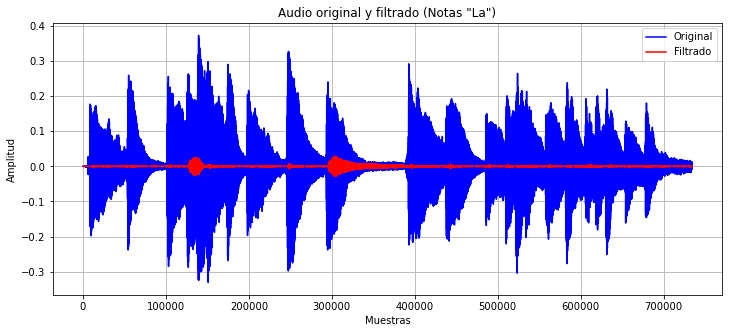

In [11]:
N = int(np.ceil((4 / width)))
taps = signal.firwin(N, [f1 / nyq_rate, f2 / nyq_rate], window='blackman', pass_zero=False)
filtered_audio = signal.lfilter(taps, 1, filtered_audios[0])

plt.figure(figsize=(12, 5))
plt.plot(filtered_audios[0], color='blue', label='Original')
plt.plot(filtered_audio, color='red', label='Filtrado')
plt.legend()
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Audio original y filtrado (Notas "La")')
plt.grid()
plt.show()

Audio(filtered_audio, rate=fs)

- ¿Qué diferencias alcanza a escuchar entre un filtrado y el otro? ¿Que ventana escogería para filtrar todas las notas y porqué?

Se escuchan las mismas diferencias que para la nota Re y escogería usar el filtro con ventana Blackman ya que aunque puede parecer que no filtra por completo lo que pasa es que conserva armónicos de las frecuencias filtradas y por esto musicalmente es mejor.

#### 1.5 Filtrar audio por notas musicales y regenerar melodía:
Finalmente filtre todas las notas musicales y sume todas las señales obtenidas para regenerar la melodía original, esto usando ambas ventanas anteriores.

Por Kaiser:

In [12]:
from scipy.io.wavfile import write

fs = 48000      # frecuencia de muestreo 
delta_f = 20   # banda de transición
ripple_db = 80  # rizado 
nyq_rate = fs / 2.0
width = delta_f / nyq_rate

# Frecuencias de corte para cada nota
frequencies = [(145,155),(280, 320), (215,222), (247, 255), (180, 190), (390, 395),(160,170)]
filtered_audios_freq = []

for f1, f2 in frequencies:
    N, beta = signal.kaiserord(ripple_db, width)  # orden y beta de Kaiser
    taps = signal.firwin(N, [f1 / nyq_rate, f2 / nyq_rate], window=('kaiser', beta), pass_zero=False)
    filtered_audio = signal.lfilter(taps, 1, filtered_audios[0])
    filtered_audios_freq.append(filtered_audio)

# Sumar todos los audios filtrados en uno solo
filtered_sum = np.sum(filtered_audios_freq, axis=0)

# Normalizar el audio filtrado
filtered_sum /= np.max(np.abs(filtered_sum))
filtered_sum *= 0.8  # Ajustar el nivel de amplitud según sea necesario

Audio(filtered_sum.astype(np.float32), rate=fs)

Por Blackman:

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io.wavfile import write

fs = 48000      # frecuencia de muestreo 
delta_f = 20   # banda de transición
ripple_db = 80  # rizado 

# Frecuencias de corte para cada nota
frequencies = [(145,155),(280, 320), (215,222), (247, 255),  (180, 190), (390, 395),(160,170)]
filtered_audios_freq = []

nyq_rate = fs / 2.0
width = delta_f / nyq_rate

for f1, f2 in frequencies:
    normalized_cutoff_hz = [f1 / nyq_rate, f2 / nyq_rate]  # Frecuencias de corte normalizadas

    N = int(np.ceil((4 / width)))
    taps = signal.firwin(N, normalized_cutoff_hz, window='blackman', pass_zero=False)
    filtered_audio = signal.lfilter(taps, 1, filtered_audios[0])
    filtered_audios_freq.append(filtered_audio)

# Sumar todos los audios filtrados en uno solo
filtered_sum = np.sum(filtered_audios_freq, axis=0)

# Normalizar el audio filtrado
filtered_sum /= np.max(np.abs(filtered_sum))
filtered_sum *= 0.8  # Ajustar el nivel de amplitud según sea necesario

Audio( filtered_sum.astype(np.float32), rate=fs)

- ¿Cuál audio le gustó más y porqué cree que es el mejor?

El que mejor suena es el filtro con Blackman debido a que en la transición de notas musicales hay mayor suavidad y se siente más afinado debido a los armónicos que no se filtran.

# 2. Sonidos respiratorios con diferentes filtros

Los sonidos respiratorios son indicadores importantes de la salud respiratoria y de los trastornos respiratorios. El sonido emitido cuando una persona respira está directamente relacionado con el movimiento del aire, los cambios en el tejido pulmonar y la posición de las secreciones dentro del pulmón. Un sonido sibilante, por ejemplo, es un signo común de que un paciente padece una enfermedad obstructiva de las vías respiratorias como el asma o la enfermedad pulmonar obstructiva crónica (EPOC).

La base de datos de sonidos respiratorios fue creada por dos equipos de investigación de Portugal y Grecia. Incluye 920 grabaciones anotadas de distinta duración: de 10 a 90 años. Las sibilancias y crepitaciones son ruidos respiratorios anormales que pueden oírse al auscultar (escuchar con un estetoscopio) los pulmones. Proporcionan información valiosa sobre el estado del aparato respiratorio y pueden ayudar a diagnosticar diversos trastornos respiratorios. Por esto se necesita filtrar el audio con el propósito de resaltar estas ruidos. 

El audio con el que se trabajará solo consiste de ruido de sibilancias y fue grabado en el pecho , posición anterior izquierda en base al etiquetado. Adicionalmente, en base a las notas de los expertos de este audio solo se presentan sibilancias. Para entrar más en contexto las sibilancias son sonidos musicales o silbidos agudos y continuos que se producen durante la espiración. Suelen estar causadas por el estrechamiento o la obstrucción parcial de las vías respiratorias, lo que provoca un flujo de aire turbulento. Es importante detectar las sibilancias, ya que indican constricción u obstrucción de las vías respiratorias, lo que puede requerir una intervención médica inmediata.

#### 2.1 Grafique la señal correspondiente a "221_2b2_Al_mc_LittC2SE.wav". Debe normalizar la señal en amplitud, eliminar su nivel DC y crear su vector de tiempo dependiendo de su frecuencia de muestreo.

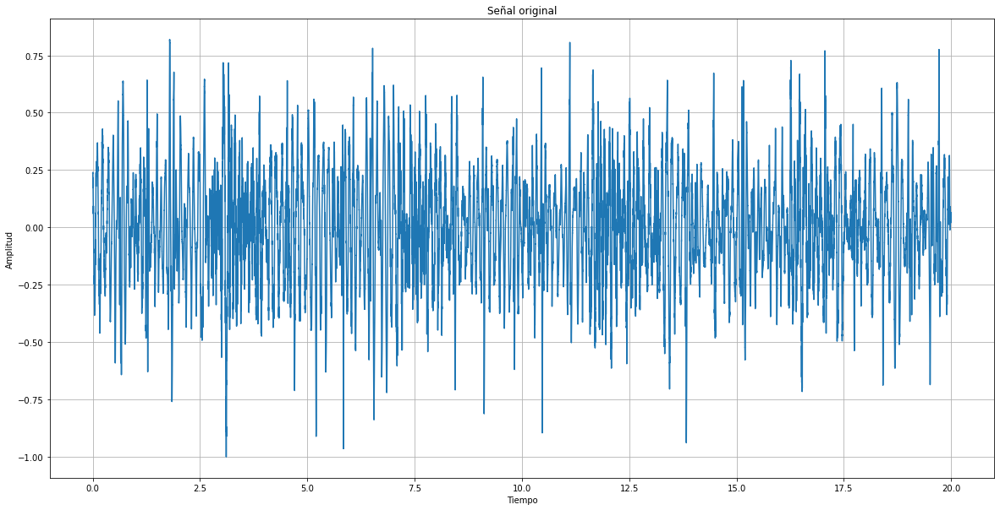

In [14]:
x,fs = graphic.show_audio("221_2b2_Al_mc_LittC2SE.wav","Tiempo","Amplitud","Señal original")

#### 2.2 Obtenga el espectrograma de la señal de audio original.

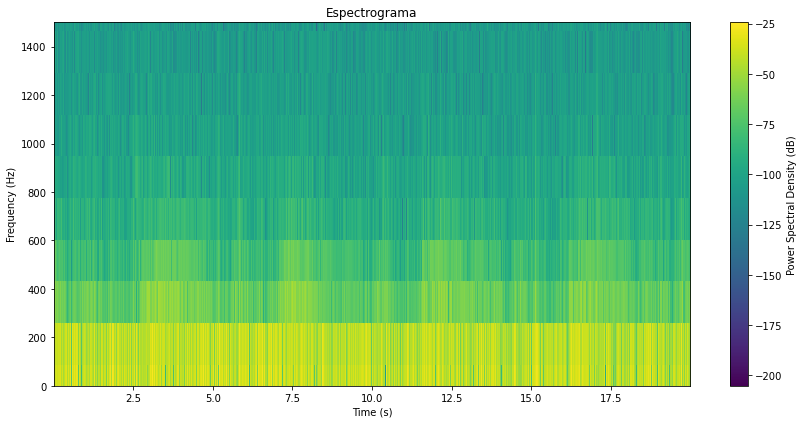

In [15]:
# Mostrar el espectrograma del audio antes del autotune
plot_spectrogram(x, fs, title='Espectrograma', freq_min=0, freq_max=1500)
Audio(x, rate=fs)

- ¿Qué se puede escuchar en el audio?

Se puede escuchar la respiración, el paso del aire y el estancaminto o las sibilancias que se mencionan. 

- ¿Que información puede extraer del espectograma?

Se evidencia que el rango de frecuencias encontradas en el audio es de 0 a 800 Hz aproximadamente y se puede ver un patrón en la magnitud de la energía espectral respecto a la respiración escuchada.

- ¿En que rando de frecuencias cree que se encuentran las sibilancias que se requieren filtrar?

En base a la explcación de estos fenómenos se espera que estos ruidos tengan una frecuencia alta, major frecuencia al paso normal del aire y que sean constantes por un tiempo determinado. Por esto se espera que sean el patron que se evidencia desde los 220Hz a 600HZ

#### 2.3 Diseñe un filtro pasa altas que permita escuchar con mayor presición las sibilancias detectadas

Es importante analizar el fenómeno que se espera detectar y el tipo de filtro que se está aplicando. Grafique la respuesta en frecuencia y seleccione los parámetros de frecuencia de corte, rizado y ancho de banda que le parezcan pertinentes para el objetivo del filtro. 

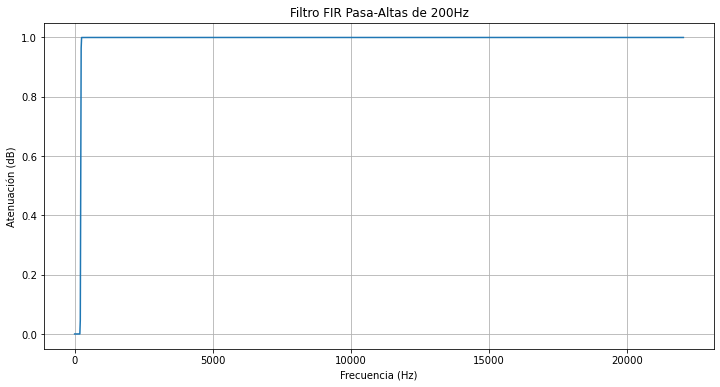

In [16]:
fc = 220
nyq_rate = fs / 2.0
delta_f = 20
ripple_db = 80
width = delta_f / nyq_rate
N = int(np.ceil((4 / width))) +1
taps = signal.firwin(N, fc/nyq_rate, window='blackman', pass_zero=False)
w, h = signal.freqz(taps, [1], worN=1400)

plt.figure(figsize=(12, 6))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Atenuación (dB)')
plt.title('Filtro FIR Pasa-Altas de 200Hz')
plt.grid()
plt.plot(nyq_rate * w / np.pi, np.abs(h))

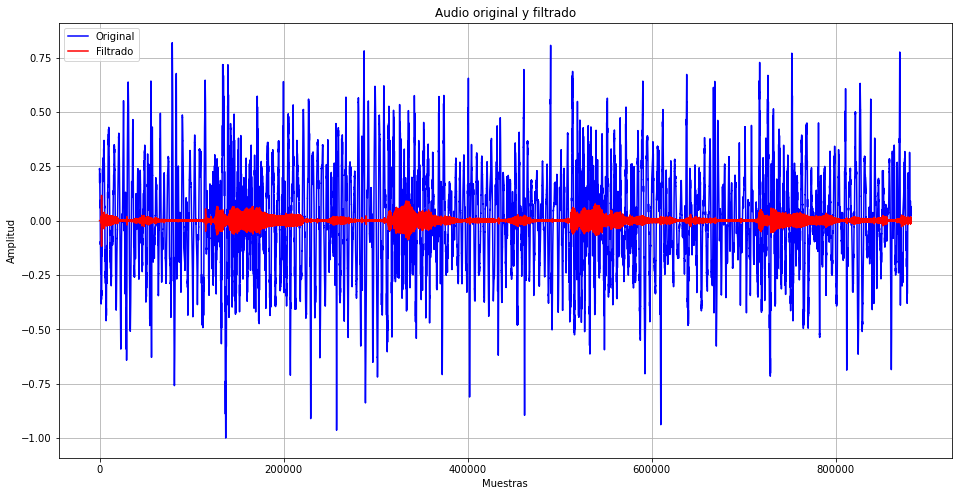

In [17]:
filtered_audio = lfilter(taps, 1, x)
plt.figure(figsize=(16, 8))
plt.plot(x, color='blue', label='Original')
plt.plot(filtered_audio, color='red', label='Filtrado')
plt.legend()
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Audio original y filtrado')
plt.grid()
plt.show()

Audio(filtered_audio, rate=fs)

- ¿Filtra correctamente las sibilancias permitiendo escuchar claramente al experto? En caso de que no sea así ¿que mejoras se pueden realizar?

Se se pueden escuchar con mayor claridad las sibilancias en comparación al audio original pero todavía se escucha mucho ruido, esto se puede mejorar aplicando al audio original un filtro pasa bandas con frecuecia de corte inferior de 220Hz y superior de 650Hz.

- ¿Que ventana escogió y porqué?

La ventana de Blackman en el diseño de un filtro pasa-altas FIR ayuda a atenuar los lóbulos laterales y lograr un buen equilibrio entre el ancho del lóbulo principal y la atenuación de los lóbulos laterales. Estas características contribuyen a mejorar la precisión, selectividad y rechazo de frecuencias no deseadas del filtro atenuando justo lo necesario para obtener las sibilancias pero sin perder las rescuencias en las cuales se escucha la respiración.

#### 2.3 Diseñe un filtro pasa bandas que permita escuchar con mayor presición las sibilancias detectadas

Diseñe este filtro en base al analisis del punto anterior.

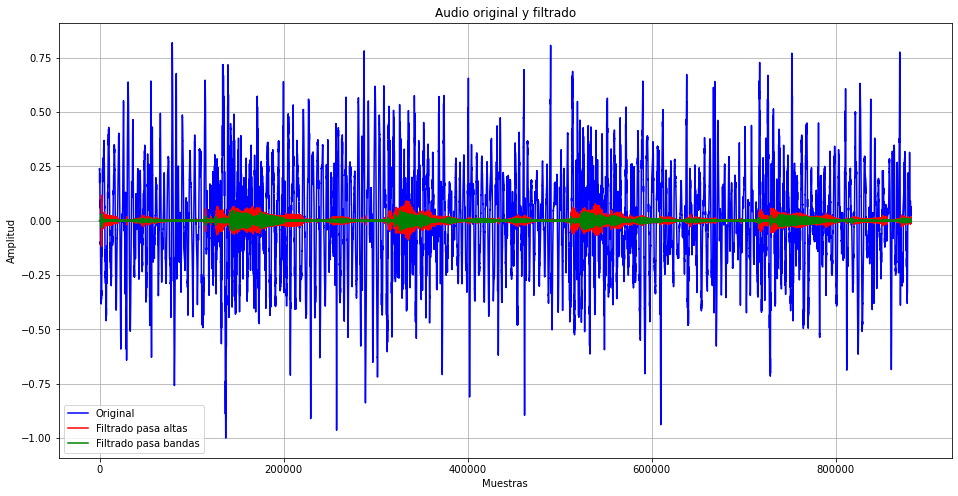

In [18]:
f1 = 300
f2 = 450
# Calcula el número de coeficientes del filtro
N = int(np.ceil((4 / width)))
taps = signal.firwin(N, [f1 / nyq_rate, f2 / nyq_rate], window='blackman', pass_zero=False)

filtered_audio2 = lfilter(taps, 1, x)
plt.figure(figsize=(16, 8))
plt.plot(x, color='blue', label='Original')
plt.plot(filtered_audio, color='red', label='Filtrado pasa altas')
plt.plot(filtered_audio2, color='green', label='Filtrado pasa bandas')
plt.legend()
plt.xlabel('Muestras')
plt.ylabel('Amplitud')
plt.title('Audio original y filtrado')
plt.grid()
plt.show()

Audio(filtered_audio2, rate=fs)

- ¿Qué aplicaciones cree usted que puede tener este filtro mas allá de la detección de la frecuencia de ls sibilancias?

La aplicación de este filtro es facilitar la detección de fenómenos en la respiación humana, por esto aplicar este filtro a un estetoscopio puede ayudar a una facil detección de una patología y facilitar la escucha de estos a los médicos.

# Conclusiones

La guía resalta la importancia de analizar a fondo el problema y seguir un planteamiento sistemático a la hora de diseñar y aplicar filtros en el tratamiento digital de señales. De esta forma se muestra que si se comprenden los requisitos específicos, se seleccionan los filtros adecuados, se configuran los parámetros y se evalúa el rendimiento, es posible obtener resultados de filtrado óptimos y mejorar eficazmente la calidad de las señales de audio. Además de que el análisis de espectrogramas desempeña un papel fundamental en el tratamiento digital de señales para comprender los componentes espectrales de una señal de audio. 

El análisis y el filtrado de los sonidos respiratorios son esenciales para comprender la salud respiratoria y diagnosticar los trastornos respiratorios. La guía presentada realiza un ejemplo para aplicar métodos de procesamiento digital de señales para mejorar sonidos respiratorios específicos de interés, como las sibilancias. Mediante la utilización de estas técnicas, los profesionales sanitarios pueden mejorar su capacidad para evaluar y tratar las afecciones respiratorias, lo que en última instancia se traduce en una mejor atención al paciente.

La aplicación de filtros FIR con diferentes funciones de ventana para aislar notas musicales de una señal de audio muestra un enfoque preciso para extraer notas específicas de una grabación musical. Al seleccionar las frecuencias de corte correspondientes a las notas deseadas, se pueden aplicar filtros para atenuar otras frecuencias y enfatizar las notas objetivo. La utilización de diferentes funciones de ventana permite ajustar con precisión la respuesta del filtro para obtener resultados óptimos para cada nota musical. 

El filtrado de señales de audio mediante filtros paso banda FIR con diversas funciones de ventana (como Hamming, Blackman, Bartlett y Kaiser) permite personalizar la respuesta del filtro para lograr el filtrado de frecuencias deseado. Cada función de ventana tiene características distintas en cuanto a atenuación de frecuencia fuera de la banda deseada y resolución de frecuencia, lo que proporciona flexibilidad a los diseñadores para adaptar el filtrado según sus necesidades específicas.